# Creation des Figures du rapport de visualisation

## Importation des principales librairies et du jeux de donnes

In [13]:
%config Completer.use_jedi = False

# Je narrivait pas a installer la librairy textBlob depuis la UI Anaconda
# Les 3 lignes ci-dessous sont a faire tourner une seule fois:

#import sys
#!{sys.executable} -m pip install textblob
#!{sys.executable} -m pip install textblob_fr

import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
import seaborn as sns
import matplotlib.pyplot as plt

fileName = 'df_complet.xlsx'
pathName = './Data'


# df=pd.read_excel(f'{pathName}\{fileName}')
df=pd.read_excel(f'{pathName}\{fileName}')

# Je supprime les lignes sans commentaires pour le moment:
df = df.dropna(subset='Commentaire')
df = df.drop(df[df['Commentaire'].isnull()].index)

df.Commentaire = df.Commentaire.str.lower()

### Figure 1: Repartion des avis par note selon statut verifie

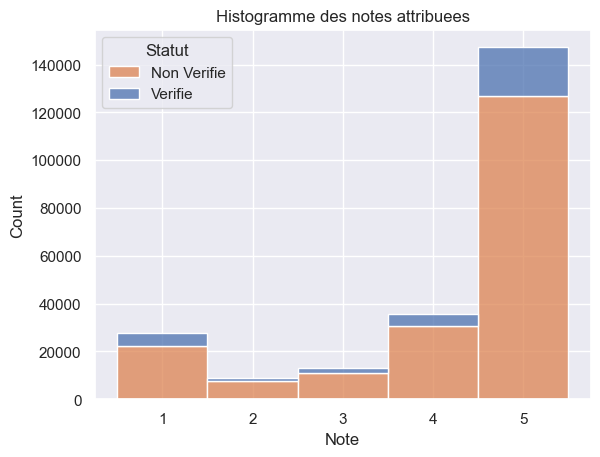

Int64Index([], dtype='int64')

In [20]:
sns.set_theme()
fig0 = sns.histplot(data=df,x='Note',hue='Verifications', multiple="stack",discrete=True)
fig0.set(title='Histogramme des notes attribuees')
plt.legend(title='Statut', loc='upper left', labels=['Non Verifie','Verifie'])
plt.show()


Commentaire

### Figure 2: Repartition des Pays

In [21]:
print(df.Pays.value_counts(normalize=True))

FR    0.982333
CH    0.003795
US    0.001854
GB    0.001764
BE    0.001342
        ...   
NZ    0.000004
BB    0.000004
LB    0.000004
TT    0.000004
NE    0.000004
Name: Pays, Length: 123, dtype: float64


On remarque que les commentaires sont dorigines Francaises a 98%.
Les autres nationnalites ne sont donc pas representatives dans ce jeux de donnes.

### Figure 3: Notes categorise par le statut verifications

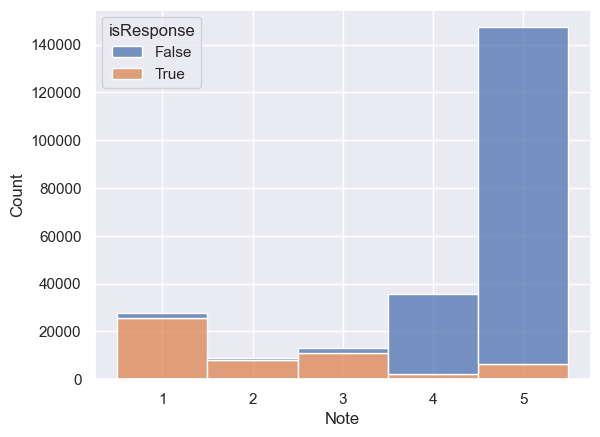

In [22]:
# Dans cette cellule je teste et compare les plots issues de plotly et seaborn
# Un seul des 2 plots sera conserve

df['isResponse'] = df.Reponse.notna()

fig3 = sns.histplot(data=df,x='Note',hue='isResponse', multiple="stack",discrete=True)
plt.show()

fig31 = px.histogram(df,x='Note',color='isResponse')#,color_discrete_sequence = px.colors.colorbrewer.Accent)
fig31.update_layout(barmode='stack',template="seaborn")
fig31.show()

### Figure 4: Mots les plus present

Creation de la fonction get_top_ngram extrait les mots ou groupes de mots les plus recurrents d'une serie de strings. Dns notre cas corpus peut etre egale a la colonne Commentaire, title ou reponse

In [23]:
from sklearn.feature_extraction.text import CountVectorizer

def get_top_ngram(corpus, n=None, ngrame=1,stopWord=True):
    """
    Compte le nombre de recurrences des ngrames presents dans le corpus et retourne le top n ngrames et leur decomptes.

    :param corpus: Serie, incluant 1 seul colonne de string
    :param n: int, Nombre de Ngrame a collecter apres triage
    :param ngrame: int, ordre du Ngrame vise. 1 mot = 1grame, couple mots se suivant = 2grame, etc
    :param stopWord: Boolean, filtre les stopWord present dans les string. La list de stop word est definie dans la
    fonction. StopWord example = le,la,les,de,je,etc
    :return: List of tuple, [(mot,nombre recense)]
    """

    items = {"ä": "a", "ç": "c", "è": "e", "º": "", "Ã": "A", "Í": "I", "í": "i", "Ü": "U", "â": "a", "ò": "o", "¿": "",
             "ó": "o", "á": "a", "à": "a", "õ": "o", "¡": "", "Ó": "O", "ù": "u", "Ú": "U", "´": "", "Ñ": "N", "Ò": "O",
             "ï": "i", "Ï": "I", "Ç": "C", "À": "A", "É": "E", "ë": "e", "Á": "A", "ã": "a", "Ö": "O", "ú": "u",
             "ñ": "n", "é": "e", "ê": "e", "·": "-", "ª": "a", "°": "", "ü": "u", "ô": "o"}

    stopWordFrench = ['alors','au','ai','aucuns','aussi','autre','avant','avec','avoir','bon','car','ce','cela',
                      'ces','ceux','chaque','ci','comme','comment','dans','de','des','du','dedans','dehors','depuis',
                      'devrait','doit','donc','dos','debut','elle','elles','en','encore','essai','est','et','eu',
                      'fait','faites','fois','font','hors','ici','il','ils','je','juste','la','le','les','leur','ma',
                      'maintenant','mais','mes','mien','moins','mon','mot','meme','ni','nommes','notre','nous','ou',
                      'par','parce','peut','plupart','pour','pourquoi','quand','que','quel','quelle','quelles',
                      'quels','qui','sa','sans','ses','seulement','si','sien','son','sont','sous','soyez','sujet',
                      'sur','ta','un','une','tandis','tellement','tels','tes','ton','tous','tout','tres','tu',
                      'voient','vont','votre','vous','vu','ca','etaient','etat','etions','ete','etre','me','chez',
                      'on','ont']

    stopWord = stopWordFrench if stopWord else None

    corpus = corpus.str.replace(r'[^\x00-\x7F]', lambda x: items.get(x.group(0)) or '_', regex=True)

    vec = CountVectorizer(ngram_range=(ngrame, ngrame), stop_words=stopWord).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    
    return words_freq[:n]


Recuperation des 20 mots les plus recurrents:

rapport qualite prix 8218
prix livraison rapide 2233
livraison rapide conforme 2100
livraison rapide prix 1994
toujours pas recu 1878
qualite prix livraison 1690
livraison rapide recommande 1513
livraison rapide pneus 1458
commande livraison rapide 1419
livraison rapide produit 1268
rapide conforme commande 1127
livraison ultra rapide 1101
rapide produit conforme 1073
service apres vente 1011
ne suis pas 984
produit conforme commande 975
parfait livraison rapide 921
pas recu pneus 843
bien livraison rapide 817
jours apres commande 791


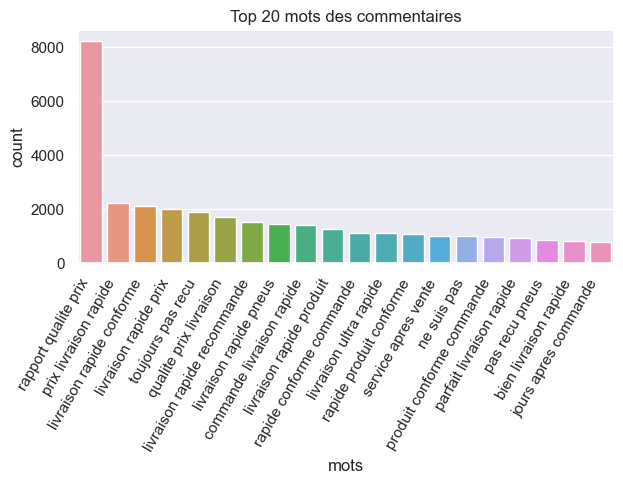

In [28]:
common_words = get_top_ngram(df['Commentaire'], n=20,ngrame=3,stopWord=True)

for word, freq in common_words:
    print(word, freq)

df_commonWord = pd.DataFrame(common_words,columns=['mots','count'])

fig4=sns.barplot(data = df_commonWord,x='mots',y='count')
fig4.set_xticklabels(fig4.get_xticklabels(),rotation=60,ha="right")
plt.tight_layout()
fig4.set(title='Top 20 mots des commentaires')

plt.show()

### Figure 5: Joint plot Note + Sentiment

PreProcessing:

In [25]:
# Code:

from textblob import Blobber
from textblob_fr import PatternTagger, PatternAnalyzer

#print(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].head())
df = df.drop(df.loc[df.Commentaire.apply(lambda x: not(isinstance(x, str)))].index)
df.reset_index()
#df.info()

# Definit objet blobber et configure les modeles francais
tb = Blobber(pos_tagger=PatternTagger(), analyzer=PatternAnalyzer())

# Fonction nettoyant le text
def preprocess(ReviewText):
    ReviewText = ReviewText.str.replace("(<br/>)", "")
    ReviewText = ReviewText.str.replace('(<a).*(>).*(</a>)', '')
    ReviewText = ReviewText.str.replace('(&amp)', '')
    ReviewText = ReviewText.str.replace('(&gt)', '')
    ReviewText = ReviewText.str.replace('(&lt)', '')
    ReviewText = ReviewText.str.replace('(\xa0)', ' ')
    return ReviewText

df['Commentaire'] = preprocess(df['Commentaire'])
df['polarity'] = df['Commentaire'].map(lambda text: tb(text).sentiment[0])


C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:23: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:24: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:25: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:26: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:27: FutureWarning:

The default value of regex will change from True to False in a future version.

C:\Users\joan\AppData\Local\Temp\ipykernel_9300\3314287606.py:28: FutureWarning:

The default value of regex will change from True to False in a future version.



Plots:

In [26]:
trace1 = go.Scatter(
    x=df['polarity'], y=df['Note'], mode='markers', name='points',
    marker=dict(color='rgb(102,0,0)', size=2, opacity=0.4)
)
trace2 = go.Histogram2dContour(
    x=df['polarity'], y=df['Note'], name='density', ncontours=20,
    colorscale='Hot', reversescale=True, showscale=False
)
trace3 = go.Histogram(
    x=df['polarity'], name='Sentiment polarity density',
    marker=dict(color='rgb(102,0,0)'),
    yaxis='y2'
)
trace4 = go.Histogram(
    y=df['Note'], name='Rating density', marker=dict(color='rgb(102,0,0)'),
    xaxis='x2'
)
data = [trace1, trace2, trace3, trace4]

layout = go.Layout(
    showlegend=False,
    autosize=False,
    width=1200,
    height=700,
    xaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    yaxis=dict(
        domain=[0, 0.85],
        showgrid=False,
        zeroline=False
    ),
    margin=dict(
        t=50
    ),
    hovermode='closest',
    bargap=0,
    xaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    ),
    yaxis2=dict(
        domain=[0.85, 1],
        showgrid=False,
        zeroline=False
    )
)

fig = go.Figure(data=data, layout=layout)
fig.update_layout(
    title={'text':"2D Density jointplot of Sentiment Polarity vs. Note",'xanchor':'center','yanchor':'top','x':0.5,'y':0.9},
    xaxis_title="Sentiment Polarity",
    yaxis_title="Note",
    margin=dict(t=100)
    )

fig.show()